In [183]:
import glob
import math
import numpy as np
import pandas as pd
from PIL import Image
from scipy import ndimage
from astropy.io import fits
import plotly.express as px
from datetime import datetime
from skimage import morphology
from matplotlib import pyplot as plt
from plotly import graph_objects as go
import plotly.io as pio
pio.renderers.default = 'iframe'

# Functions

## Calculation Routines

In [329]:
def get_val(array, percent, abs_percent=True):
    array = array[~np.isnan(array)]
    
    if abs_percent:
        min_val = np.min(array)
        max_val = np.max(array)
        array_range = max_val - min_val
        val = percent/100 * array_range + min_val
    else:
        max_val = np.max(array)
        val = max_val * percent/100
    
    return val


def get_percent(array, val, abs_percent=True):
    array = array[~np.isnan(array)]
    
    if abs_percent:
        min_val = np.min(array)
        max_val = np.max(array)
        array_range = max_val - min_val
        percent = (val - min_val)/array_range * 100
    else:
        max_val = np.max(array)
        percent = val/max_val * 100
    
    return percent


def get_peak(array, percent=True):
    hist, edges = get_hist(array, percent=percent)
    peak_i = np.argmax(hist)
    
    return (edges[peak_i] + edges[peak_i+1])/2


def get_percent_to_peak_percent(array, percent_to_peak):
    percent_of_zero_val = get_percent(array, 0)
    peak_percent = get_peak(array, percent=True)
    
    return percent_to_peak/100*(peak_percent - percent_of_zero_val) + \
        percent_of_zero_val


def get_hist(array, percent=True, n=1000):
    """Get counts in each of n bins and a list of bin edges as a % of max value or in raw values"""
    array = array[~np.isnan(array)]
    min_val = np.min(array)
    max_val = np.max(array)
    
    histogram, bin_edges = np.histogram(array, bins=n, range=(min_val,max_val))

    if percent:
        array_range = max_val - min_val
        bin_edges = 100 / array_range * (bin_edges - min_val)
    
    return histogram, bin_edges

### Extraction

In [3]:
src_folder = 'Desktop/CHS_DETECT/'

def extract_fits(file_num, src_folder=src_folder):
    fits_list = glob.glob(src_folder + 'Renamed_FITS/*.fts')
    fits_list.sort()
        
    he_fits_files = [fits.open(fits_path) for fits_path in fits_list]
    he_fits = he_fits_files[file_num]

    # Flip data to visualize arrays as images
    eqw = np.flip(he_fits[0].data[0], axis=0)
    continuum = np.flip(he_fits[0].data[1], axis=0)
    try:
        cloud = np.flip(he_fits[0].data[2], axis=0)
    except:
        cloud = np.zeros_like(continuum)
    
    date = datetime.strptime(he_fits[0].header['DATE'], 
                             '%Y-%m-%dT%H:%M:%S')
    
    try:
        titles = [he_fits[0].header[f'IMTYPE{i}'] for i in range(1,4)]
    except:
        titles = [f'Array {i}' for i in range(1,4)]
        
    return eqw, continuum, cloud, date, titles


def extract_euv(file_num, src_folder=src_folder):
    euv_list = glob.glob(src_folder + 'Renamed_EUV/*.png')
    euv_list.sort()
    euv = Image.open(euv_list[file_num])
    
    return euv
    

def edit_eqw(eqw, peak_count_cutoff_percent=0.1):
    """
    Args
        peak_count_cutoff_percent: Vertical cutoff for histogram
            counts below a percentage
    """
    eqw_nan = np.where(eqw == 0, np.NaN, eqw)

    hist, edges = get_hist(eqw_nan)
    max_count = np.max(hist)

    cutoff = max_count*peak_count_cutoff_percent/100
    cutoff_edges = np.where(hist > cutoff, get_val(eqw_nan, edges[:-1]), 0)

    eqw_high_cut = np.where(eqw > np.max(cutoff_edges), np.NaN, eqw_nan)

    eqw_band_cut = np.clip(eqw_high_cut, np.min(cutoff_edges), np.max(cutoff_edges))
    
    return eqw_band_cut, eqw_high_cut, eqw_nan

### Segmentation

In [359]:
MIN_SIZE = 5000


def thresh(array, thresh_percent):
    """Take binary threshold of image.
    
    Args
        array: image to process
        thresh_percent: float percentage value in [0,100] at which to take threshold
    Returns
        Binary array with 1 values for pixels above threshold and 0 values elsewhere.
    """
    bound = get_val(array, thresh_percent)
    return np.where(array > bound, 1, 0)


def morph(array, morph_radius):
    """Perform morphological operations.
    
    Args
        array: image to process
        morph_radius: int pixel number for radius of disk structuring element
                      in morphological operations
    Returns
        Array that has been processed via morphological opening and closing.
    """
    open_array = morphology.binary_opening(array, morphology.disk(morph_radius))
    return morphology.binary_closing(open_array, morphology.disk(morph_radius))


def fill_rm(array, min_size):
    """Fill small holes within regions and remove small holes outside regions.
    
    Args
        array: image to process
        min_size: int pixel number for area of smallest region to preserve
    Returns
        Array that has been processed via fill and removal of small holes.
    """
    fill_array = ndimage.binary_fill_holes(array)    
    return morphology.remove_small_objects(fill_array, min_size=min_size)


def get_holes_mask(array, thresh_percent, morph_radius, min_size=MIN_SIZE):
    """Retrieve a single segmentation.
    
    Args
        array: image to process
        thresh_percent: float percentage value in [0,100] at which to take threshold
        morph_radius: int pixel number for radius of disk structuring element
                      in morphological operations
        min_size: int pixel number for area of smallest region to preserve
    Returns
        Binary coronal holes mask.
    """
    holes_mask = thresh(array, thresh_percent=thresh_percent)
    holes_mask = morph(holes_mask, morph_radius=morph_radius)
    holes_mask = fill_rm(holes_mask, min_size=min_size)

    return holes_mask


def get_holes_mask_list(array, percent_of_peak_list, morph_radius_list):
    """Retrieve a list of segmentations.
    
    Args
        array: image to process
        percent_of_peak_list: list of float percentage values in [0,100] 
                              at which to take threshold
        morph_radius: int pixel number for radius of disk structuring element
                      in morphological operations
        min_size: int pixel number for area of smallest region to preserve
    Returns
        List of binary coronal holes masks.
    """
    array_width = array.shape[0]

    thresh_percent_list = [get_percent_to_peak_percent(
        array, percent_to_peak=percent_of_peak)
                           for percent_of_peak in percent_of_peak_list]
    
    holes_mask_list = [get_holes_mask(array, thresh_percent=thresh_percent,
                                      morph_radius=morph_radius, min_size=MIN_SIZE)
                       for thresh_percent in thresh_percent_list
                       for morph_radius in morph_radius_list]
        
    return holes_mask_list

### Candidates

In [408]:
def get_masked_candidates(array, holes_mask):
    inverted_holes_mask = np.where(holes_mask == 1, 0, 1)

    masked_candidates = np.ma.array(array, mask=inverted_holes_mask)
    
    return masked_candidates


def get_hole_im_list(array, labeled_candidate_holes, num_holes):
    hole_im_list = [np.where(labeled_candidate_holes == hole_num + 1, 
                             array, np.NaN)
                    for hole_num in range(num_holes)]
    return hole_im_list


def get_hole_lower_tail_widths(hole_im_list):
    filt_hole_im_list = [hole_im[~np.isnan(hole_im)]
                         for hole_im in hole_im_list]
    
    # List of the 1st percentile brightness value of each CH
    first_percentile_list = [np.percentile(hole_im, 1)
                             for hole_im in filt_hole_im_list]
        
    # List of peak count of each CH
    peak_count_list = [get_peak(hole_im, percent=False)
                       for hole_im in filt_hole_im_list]

    # List of lower tail widths of each CH
    hole_lower_tail_width_list = [
        peak_count - first_percentile
        for peak_count, first_percentile 
        in zip(peak_count_list, first_percentile_list)]
    
    return hole_lower_tail_width_list

### Outcomes

In [424]:
def get_thresh_pixel_percent_list(array, parameter_list):
    """"""
    thresh_bound_list = [get_val(
        array, get_percent_to_peak_percent(array, percent_to_peak=percent_of_peak))
                   for percent_of_peak in parameter_list]
    pixel_percent_list = [np.count_nonzero(array > thresh_bound)*
                          100/array.size
                          for thresh_bound in thresh_bound_list]
    
    return pixel_percent_list
    

def get_parameter_stats(pixel_percent_list):
    """"""
    pixel_percent_median = np.percentile(pixel_percent_list, 50)
    
    pixel_percent_diffs = np.abs(np.diff(pixel_percent_list))

    max_diff_i = np.argmax(pixel_percent_diffs)
    max_diff = np.max(pixel_percent_diffs)*100/pixel_percent_list[max_diff_i]
    
    cutoff = np.mean([pixel_percent_list[max_diff_i], 
                      pixel_percent_list[max_diff_i + 1]])

    selected_parameter_num = np.count_nonzero(pixel_percent_list > cutoff)
    
    return max_diff, cutoff, selected_parameter_num, pixel_percent_diffs


def get_area_percent_list(holes_mask_list):
    """"""    
    return [np.count_nonzero(holes_mask)*100/edit_im.size
            for holes_mask in holes_mask_list]


def get_num_holes_list(holes_mask_list):
    """"""    
    return [ndimage.label(holes_mask)[1]
            for holes_mask in holes_mask_list]


def get_lower_tail_width_list(array, holes_mask_list): 
    """"""
    labeled_holes_list = [ndimage.label(holes_mask)[0]
                          for holes_mask in holes_mask_list]
    num_holes_list = get_num_holes_list(holes_mask_list)
    
    # List of average lower tail widths across all CH's of each segmentaion
    lower_tail_width_list = []
    
    count = 0
    for labeled_holes_mask, num_holes in zip(labeled_holes_list, num_holes_list):
        print(count)
        # List of each CH images
        hole_im_list = get_hole_im_list(array, labeled_holes_mask, num_holes)
    
        holes_mask_lower_tail_width_list = get_hole_lower_tail_widths(hole_im_list)
        
        mean_lower_tail_width = np.mean(holes_mask_lower_tail_width_list)
        
        lower_tail_width_list.append(mean_lower_tail_width)
        count = count + 1
        
    return lower_tail_width_list

### Ensemble

In [6]:
EMPTY_DISK_VAL = -25


def get_ensemble(array, percent_of_peak_list, morph_radius_list):
    """
    """
    ensemble_size = len(percent_of_peak_list) * len(morph_radius_list)
    confidence_list = [(c + 1)*100/ensemble_size
                       for c in range(ensemble_size)]

    holes_mask_list = get_holes_mask_list(
        array, percent_of_peak_list, morph_radius_list)

    ensemble_map = np.where(~np.isnan(array), EMPTY_DISK_VAL, np.nan)
    
    for holes_mask, mask_num in zip(holes_mask_list, range(ensemble_size)):
        ensemble_map = np.where(holes_mask == 1, 
                                mask_num*100/(ensemble_size - 1), ensemble_map)
        
    return ensemble_map, holes_mask_list, confidence_list

## Plotting Routines

In [7]:
def plot_hists(arrays, titles, ns=[1000,1000], semilogy=True):
    fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(40, 10))
    ax = axes.ravel()

    ax[0].set_title(titles[0], fontsize=24)
    ax[0].imshow(arrays[0], cmap=plt.cm.gray)
    hist, edges = get_hist(arrays[0], n=ns[0])
    if semilogy:
        ax[1].semilogy(edges[0:-1], hist)
    else:
        ax[1].plot(edges[0:-1], hist)
        
    ax[2].set_title(titles[1], fontsize=24)
    ax[2].imshow(arrays[1], cmap=plt.cm.gray)
    hist, edges = get_hist(arrays[1], n=ns[1])
    if semilogy:
        ax[3].semilogy(edges[0:-1], hist)
    else:
        ax[3].plot(edges[0:-1], hist)
        
        
def plot_ims(im_list, title_list, n):
    fig, axes = plt.subplots(nrows=1, ncols=n, figsize=(10*n, 10))
    ax = axes.ravel()
    
    for i in range(0,n):
        ax[i].imshow(im_list[i], cmap=plt.cm.gray)
        ax[i].set_title(title_list[i], fontsize=24)

### Parameters

In [224]:
GREEN = '#6ece58'
BLUE = '#3e4989'
ORANGE = '#fd9668'
PURPLE = '#721f81'


def plot_thresholds(array, bounds, percent=True):
    """Plot image array, its histogram, and 3 thresholded images
    with their histograms.
    
    Args
        array: image as Numpy array
        bounds: list of threshold bounds from 0-100 %
        abs_percent: Specify as false to take bounds relative to 0 value
    """
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(40, 15))
    ax = axes.ravel()

    ax[0].imshow(array, cmap=plt.cm.gray)
    hist, edges = get_hist(array, percent=percent)
    ax[1].set_title('Histogram', fontsize=24)
    ax[1].plot(edges[0:-1], hist)

    for i in range(3):
        img_i = (i + 1)*2
        hist_i = (i + 1)*2 + 1

        ax[hist_i].semilogy(edges[0:-1], hist)
        
        percent_bound = bounds[i]
        bound = get_val(array, percent_bound, abs_percent=True)
        edit_im = np.where(array > bound, 1, 0)
        line_percent = get_percent(array, bound)

        ax[hist_i].set_title((f'Threshold: >{percent_bound:.2f}% ' +
                             '| Semilog Histogram'),
                             fontsize=24)
        ax[hist_i].axvline(line_percent, color='r')
        ax[hist_i].axvspan(line_percent, np.max(edges), 
                           color='y', alpha=0.1, lw=0)
        ax[img_i].imshow(edit_im)
        
        
def plot_pixel_percent_bars(ax, parameter_list, pixel_percent_list,
                            max_diff, cutoff, selected_parameter_num,
                            step, title, unit, xlabel, thresh=True):
    parameter_num = len(parameter_list)
    bar_width = 0.8*step
    selected_parameters = parameter_list[selected_parameter_num:]
    
    ax.set_title(f'{title}\n Cutoff: {selected_parameters[0]}{unit} | ' +
                 f'Max Difference: {max_diff:.1f}%' , fontsize=28)
    ax.set_xlabel(xlabel, fontsize=24)
    
    ax.set_ylabel('Pixel Percentage (%)', fontsize=24)
    
    ax.plot([parameter_list[0] - step/2, parameter_list[-1] + step/2], [cutoff, cutoff], 
               linestyle='--', color='k', linewidth=3)
    
    if thresh:
        ax.bar(parameter_list, pixel_percent_list, 
               width=bar_width, color=BLUE)
        ax.bar(selected_parameters, 
               pixel_percent_list[selected_parameter_num:], 
               width=bar_width, color=GREEN)
    else:
        ax.bar(parameter_list, pixel_percent_list,
               width=bar_width, color=PURPLE)
        ax.bar(selected_parameters,
               pixel_percent_list[selected_parameter_num:], 
               width=bar_width, color=ORANGE)

 ### Outcomes

In [407]:
def plot_heat_map(outcome_list, title, percent_of_peak_list, morph_radius_list, 
                  color_scale='Magma'):
    outcome_map = np.flipud(np.reshape(
        outcome_list, (len(percent_of_peak_list),len(morph_radius_list))).T)

    fig = px.imshow(outcome_map, 
                    labels=dict(x='Percent of Peak Pixel Count (%)',
                                y='SE Disk Radius (px)'),
                    x=percent_of_peak_list, y=morph_radius_list,
                    aspect='auto', color_continuous_scale=color_scale)
    fig.update_layout(title=title)
    fig.show()
    
    
def plot_heat_map_band(outcome_list, heat_map_title, lower_bound, upper_bound,
                       percent_of_peak_list, morph_radius_list, 
                       array, heat_holes_mask_list, title_list, color_scale='Magma'):
    
    # Index list of outcomes within bounds 
    i_list = [i for i in range(len(outcome_list)) 
              if outcome_list[i] >= lower_bound and outcome_list[i] <= upper_bound]
    num_holes_masks = len(i_list)
    
    # Highlight outcomes within bounds
    for i in i_list:
        outcome_list[i] = 100

    plot_heat_map(outcome_list, heat_map_title,
                  percent_of_peak_list, morph_radius_list, color_scale)
    
    fig, axes = plt.subplots(nrows=1, ncols=num_holes_masks, figsize=(10*num_holes_masks, 10))
    ax = axes.ravel()
    
    for i in range(num_holes_masks):
        # Outcome index 
        out_i = i_list[i]
        ax[i].imshow(array, cmap=plt.cm.afmhot)
        ax[i].contour(heat_holes_mask_list[out_i], cmap=plt.cm.binary)
        ax[i].set_title(title_list[out_i], fontsize=24)
        
        
def plot_hole_tail_widths(array, holes_mask):
    """"""
    masked_candidates = get_masked_candidates(edit_im, holes_mask)
    labeled_candidate_holes, num_holes = ndimage.label(holes_mask)
    
    xlim_min = np.min(masked_candidates[~np.isnan(masked_candidates)])/4
    xlim_max = np.max(masked_candidates[~np.isnan(masked_candidates)])

    hole_im_list = get_hole_im_list(
        array, labeled_candidate_holes, num_holes)
        
    hole_lower_tail_width_list = get_hole_lower_tail_widths(hole_im_list)
    
    sorted_candidate_nums = np.argsort(hole_lower_tail_width_list)

    for r in range(math.ceil(num_holes/2)):
        fig, axes = plt.subplots(nrows=1, ncols=6, figsize=(60, 10))
        ax = axes.ravel()
        
        for c in range(2):
            i = 2*r + c
            ax_i = 3*c
            if i + 1 > num_holes:
                return
            
            hole_num = sorted_candidate_nums[i]
            
                
            hole_im = np.where(labeled_candidate_holes == hole_num + 1,
                               array, np.NaN)
            hole_contour = np.where(labeled_candidate_holes == hole_num + 1,
                                    1, 0)

            y, x = np.where(~np.isnan(hole_im))
            hole_focus = hole_im[np.min(y) - 10:np.max(y) + 10,
                                 np.min(x) - 10:np.max(x) + 10]
                
            unique_val_num = np.unique(hole_focus).size
            hist, edges = get_hist(hole_focus[~np.isnan(hole_focus)], percent=False, n=100)
            
            ax[ax_i].set_title(f'Hole {hole_num + 1}', fontsize=32)
            ax[ax_i].imshow(array, cmap=plt.cm.afmhot)
            ax[ax_i].contour(hole_contour, cmap=plt.cm.binary)
            
            ax[ax_i + 1].imshow(hole_focus, cmap=plt.cm.magma)

            ax[ax_i + 2].set_title(
                f'1% to Peak Width: {hole_lower_tail_width_list[hole_num]:.1f}',
                fontsize=32)
            ax[ax_i + 2].bar(edges[0:-1], hist)
            ax[ax_i + 2].set_xlim([xlim_min, xlim_max])

### Ensemble

In [9]:
def plot_ensemble(array, ensemble_map, confidence_list, 
                  title_list, holes_mask_list):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 10))
    ax = axes.ravel()
    
    ax[0].imshow(array, cmap=plt.cm.gray)
    ax[1].imshow(ensemble_map, cmap=plt.cm.magma)

    for row in range(math.ceil(len(holes_mask_list)/3)):
        fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(30, 10))
        ax = axes.ravel()
        
        for col in range(3):
            i = 3*row + col
            if i + 1 > len(holes_mask_list):
                return

            title = f'{confidence_list[i]:.1f}% Confidence\n' + title_list[i]
            
            ax[col].set_title(title, fontsize=28)
            ax[col].imshow(holes_mask_list[i], cmap=plt.cm.gray)
            
            
def plot_ensemble_comparison(array, date, ensemble_map, euv):
    fig, axes = plt.subplots(nrows=1, ncols=3, 
                             figsize=(30, 10))
    ax = axes.ravel()
    
    ax[0].set_title(datetime.strftime(date, "%b %d, %Y %H:%M"), fontsize=24)
    ax[0].imshow(array, cmap=plt.cm.gray)

    ax[2].imshow(euv)

    ax[1].imshow(ensemble_map, cmap=plt.cm.magma)

# Parameters

## Threshold

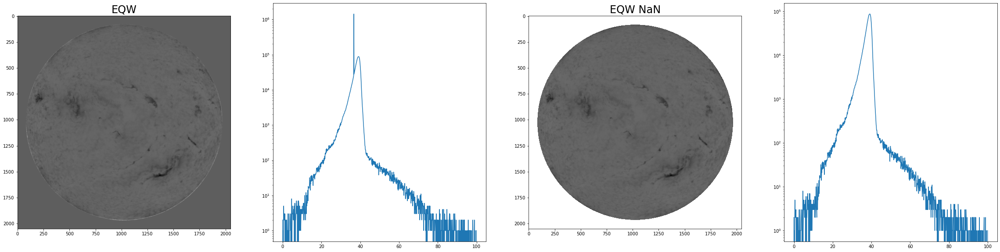

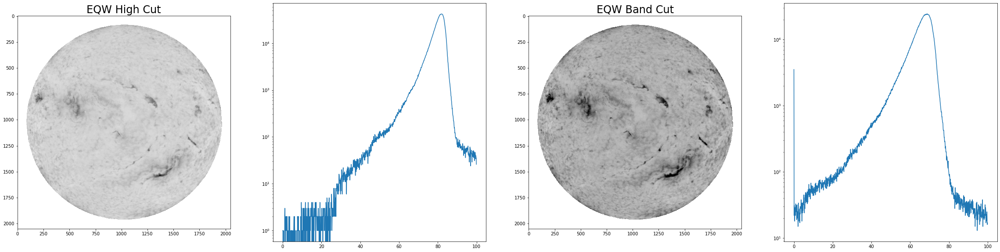

In [330]:
# 0-9
file_num = 9

eqw = extract_fits(file_num=file_num)[0]
eqw_band_cut, eqw_high_cut, eqw_nan = edit_eqw(eqw, peak_count_cutoff_percent=0.1)

arrays = [eqw, eqw_nan, eqw_high_cut, eqw_band_cut]
titles = ['EQW', 'EQW NaN', 'EQW High Cut', 'EQW Band Cut']

plot_hists(arrays[0:2], titles[0:2], semilogy=True)
plot_hists(arrays[2:4], titles[2:4], semilogy=True)

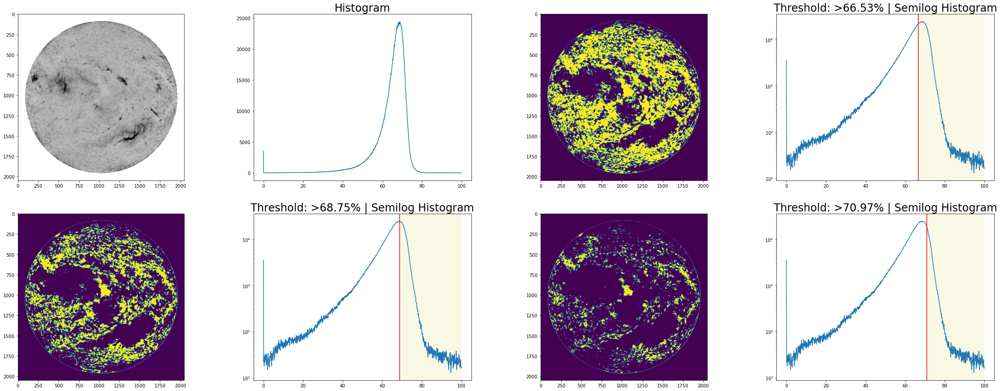

In [11]:
# 0-9
file_num = 9

eqw = extract_fits(file_num=file_num)[0]
edit_im = edit_eqw(eqw, peak_count_cutoff_percent=0.1)[0]

thresh_percent_list = [get_percent_to_peak_percent(
    edit_im, percent_to_peak=percent_of_peak)
                      for percent_of_peak in [75, 100, 125]]
plot_thresholds(edit_im, bounds=thresh_percent_list)

In [ ]:
#     [print(f'{percent_of_peak/100:.3f}% Diff:{pixel_percent_diff:1.3f}', end =' | ') 
#      for percent_of_peak, pixel_percent_diff 
#      in zip(percent_of_peak_list, pixel_percent_diffs)]
#     print('\n\n')

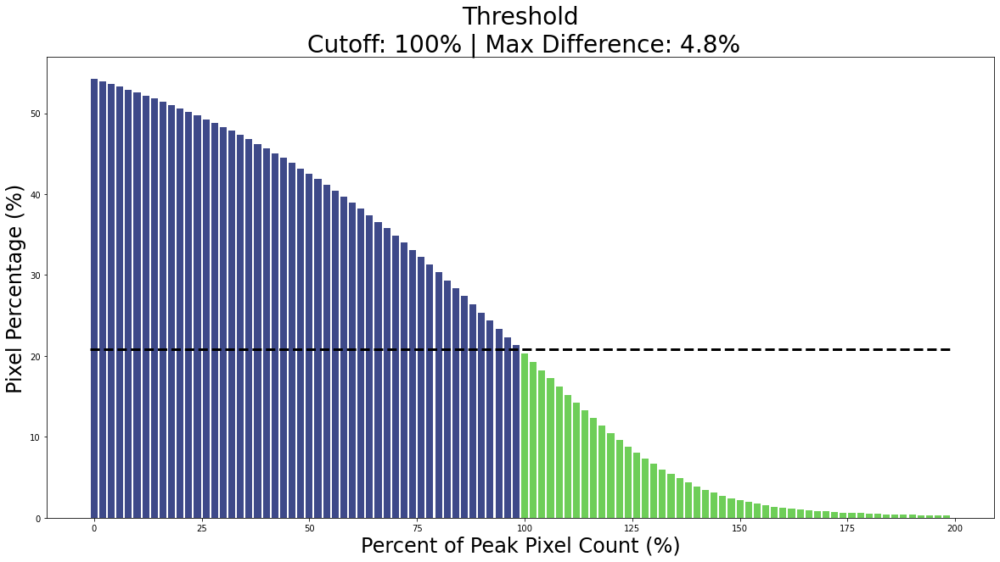

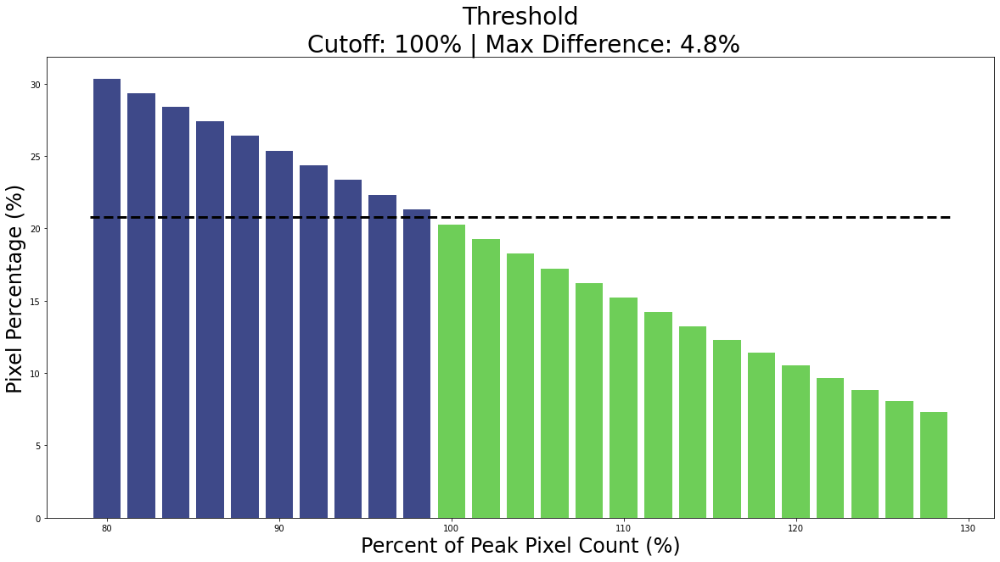

In [271]:
# 0-9
file_num = 9

step = 2
percent_of_peak_lists = [list(np.arange(0,200,step)), list(np.arange(80,130,step))]

eqw = extract_fits(file_num=file_num)[0]
edit_im = edit_eqw(eqw, peak_count_cutoff_percent=0.1)[0]

for percent_of_peak_list in percent_of_peak_lists:
    pixel_percent_list = get_thresh_pixel_percent_list(edit_im, percent_of_peak_list)
    max_diff, cutoff, selected_parameter_num, pixel_percent_diffs = get_parameter_stats(
        pixel_percent_list)
    
    fig = plt.figure(figsize=(20, 10))
    ax = fig.add_subplot()

    plot_pixel_percent_bars(
        ax, percent_of_peak_list, pixel_percent_list, max_diff, cutoff, selected_parameter_num,
        step, title='Threshold', unit='%', xlabel='Percent of Peak Pixel Count (%)', thresh=True)

## Structuring Element Radius

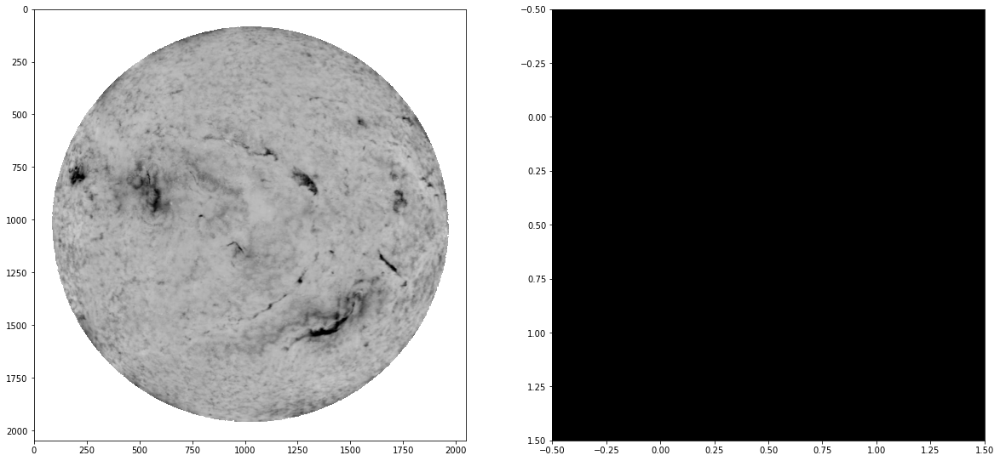

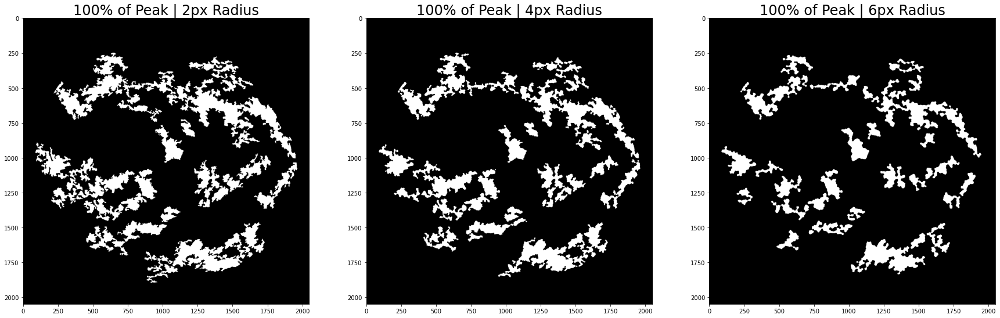

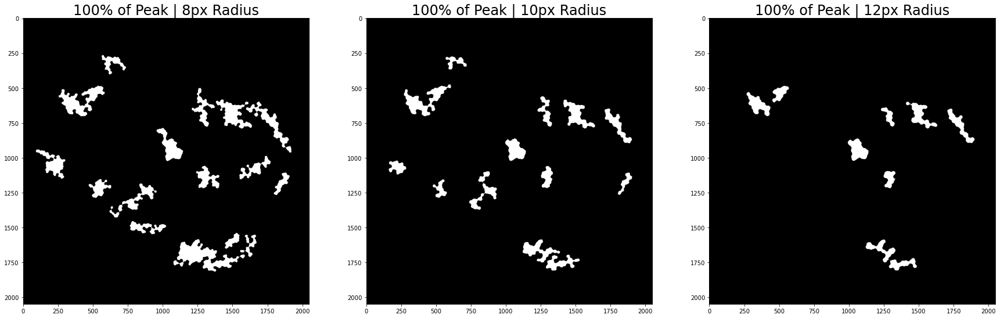

In [26]:
# 0-9
file_num = 9

percent_of_peak_list = [100]
morph_radius_list = [2,4,6,8,10,12]

eqw = extract_fits(file_num=file_num)[0]
edit_im = edit_eqw(eqw, peak_count_cutoff_percent=0.1)[0]

holes_mask_list = get_holes_mask_list(edit_im, percent_of_peak_list, morph_radius_list)
title_list = [f'{percent_of_peak:d}% of Peak | {radius:d}px Radius'
              for percent_of_peak in percent_of_peak_list
              for radius in morph_radius_list]
plot_ims([edit_im, [[0,0],[0,0]]], ['',''], n=2)
plot_ims(holes_mask_list[:3], title_list[:3], n=3)
plot_ims(holes_mask_list[3:], title_list[3:], n=3)

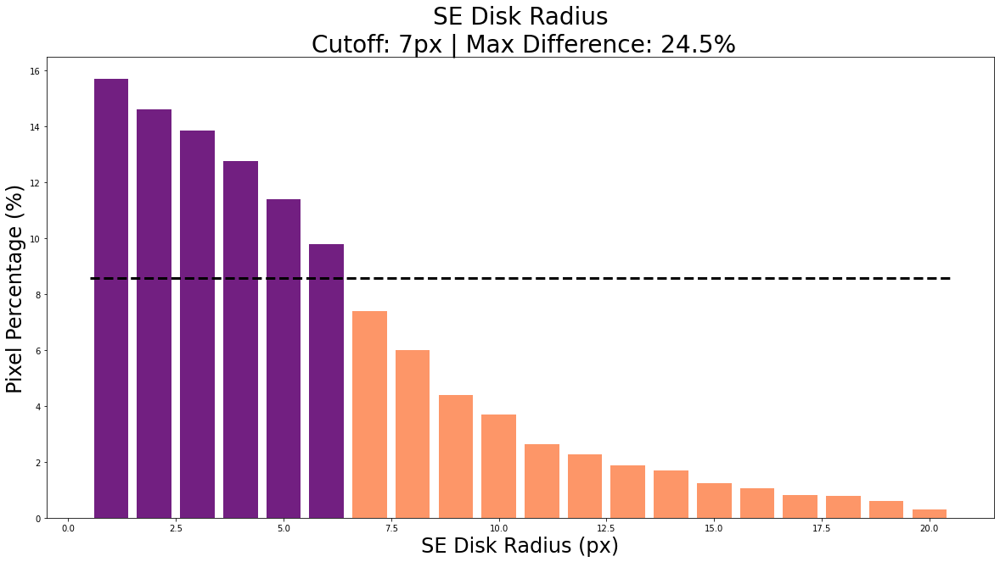

In [294]:
# 0-9
file_num = 9

step = 1
morph_radius_lists = [list(np.arange(1,21,step))]
percent_of_peak_list = [100]

eqw = extract_fits(file_num=file_num)[0]
edit_im = edit_eqw(eqw, peak_count_cutoff_percent=0.1)[0]

for morph_radius_list in morph_radius_lists:
    holes_mask_list = get_holes_mask_list(edit_im, percent_of_peak_list, morph_radius_list)
    
    pixel_percent_list = get_mask_pixel_percent_list(holes_mask_list)
    max_diff, cutoff, selected_parameter_num, pixel_percent_diffs = get_parameter_stats(
        pixel_percent_list)
    
    fig = plt.figure(figsize=(20, 10))
    ax = fig.add_subplot()

    plot_pixel_percent_bars(
        ax, morph_radius_list, pixel_percent_list, max_diff, cutoff, selected_parameter_num,
        step, title='SE Disk Radius', unit='px', xlabel='SE Disk Radius (px)', thresh=False)

# Outcomes

In [240]:
# 0-9
file_num = 9

thresh_step = 5
radius_step = 1
percent_of_peak_list = list(np.arange(80,116,thresh_step))
morph_radius_list = list(np.arange(5,18,radius_step))
title_list = [f'{percent_of_peak:d}% of Peak | {radius:d}px Radius'
              for percent_of_peak in percent_of_peak_list
              for radius in morph_radius_list]

eqw = extract_fits(file_num=file_num)[0]
edit_im = edit_eqw(eqw, peak_count_cutoff_percent=0.1)[0]

heat_holes_mask_list = get_holes_mask_list(edit_im, percent_of_peak_list, morph_radius_list)
morph_radius_list.reverse()

## Area

In [244]:
area_percent_list = get_area_percent_list(heat_holes_mask_list)

In [251]:
heat_map_title = 'Segmented Area Percentage'

outcome_list = area_percent_list.copy()
outcome_list[-1] = -5

plot_heat_map(outcome_list, heat_map_title, percent_of_peak_list, morph_radius_list)

(array([29, 16,  8,  7,  5,  4,  4,  3,  3,  2,  3,  1,  1,  1]), array([ 1.,  3.,  5.,  7.,  9., 11., 13., 15., 17., 19., 21., 23., 25.,
       27., 29.]))


<ipython-input-229-12e125a304db>:6: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



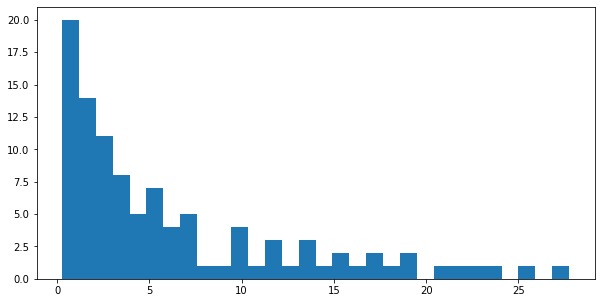

In [229]:
fig = plt.figure(figsize=(10, 5))
ax = fig.add_subplot()

print(np.histogram(edit_list, range=(1,29), bins=14))
ax.hist(outcome_list[:-1], bins=30)
fig.show()

### Heat Map Bands

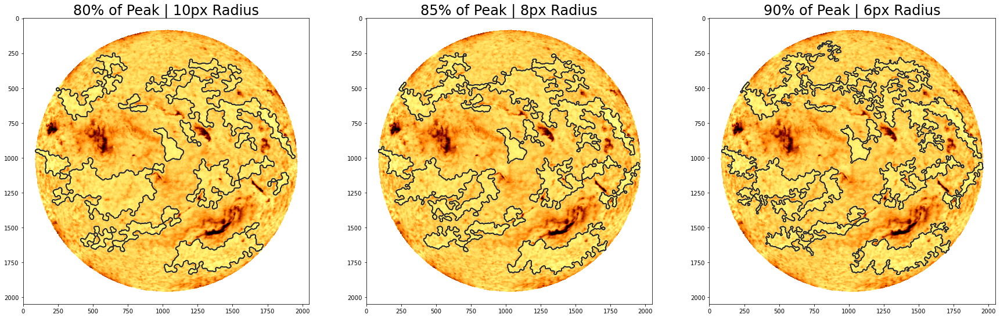

In [235]:
heat_map_title = 'Segmented Area Percentage'
lower_bound = 16
upper_bound = 18

outcome_list = area_percent_list.copy()

plot_heat_map_band(outcome_list, heat_map_title, lower_bound, upper_bound,
                   percent_of_peak_list, morph_radius_list, 
                   edit_im, heat_holes_mask_list, title_list)

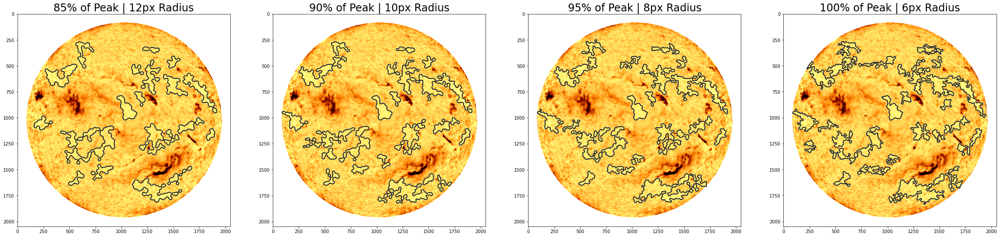

In [236]:
heat_map_title = 'Segmented Area Percentage'
lower_bound = 7.5
upper_bound = 10

outcome_list = area_percent_list.copy()

plot_heat_map_band(outcome_list, heat_map_title, lower_bound, upper_bound,
                   percent_of_peak_list, morph_radius_list, 
                   edit_im, heat_holes_mask_list, title_list)

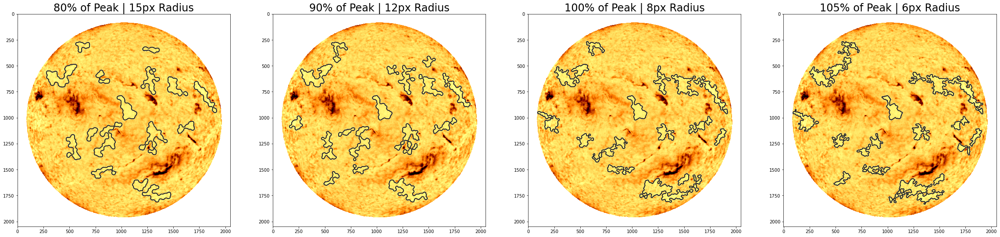

In [237]:
heat_map_title = 'Segmented Area Percentage'
lower_bound = 5.7
upper_bound = 6

outcome_list = area_percent_list.copy()

plot_heat_map_band(outcome_list, heat_map_title, lower_bound, upper_bound,
                   percent_of_peak_list, morph_radius_list, 
                   edit_im, heat_holes_mask_list, title_list)

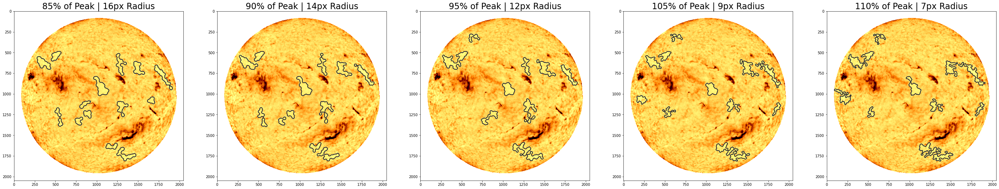

In [238]:
heat_map_title = 'Segmented Area Percentage'
lower_bound = 3.1
upper_bound = 3.5

outcome_list = area_percent_list.copy()

plot_heat_map_band(outcome_list, heat_map_title, lower_bound, upper_bound,
                   percent_of_peak_list, morph_radius_list, 
                   edit_im, heat_holes_mask_list, title_list)

### Multi Heat Map

In [181]:
thresh_step = 5
radius_step = 1
percent_of_peak_list = list(np.arange(90,111,thresh_step))

pixel_percent_lists = []

for file_num in range(10):
    morph_radius_list = list(np.arange(2,13,radius_step))
    
    eqw = extract_fits(file_num=file_num)[0]
    edit_im = edit_eqw(eqw, peak_count_cutoff_percent=0.1)[0]

    holes_mask_list = get_holes_mask_list(edit_im, percent_of_peak_list, morph_radius_list)
    morph_radius_list.reverse()
    
    pixel_percent_list = get_mask_pixel_percent_list(holes_mask_list)
    pixel_percent_lists.append(pixel_percent_list)

In [ ]:
edit_lists = pixel_percent_lists
edit_lists = [edit_list[-1] = -5 for edit_list in edit_lists]
[plot_heat_map(edit_list, percent_of_peak_list, morph_radius_list)
 for edit_list in edit_lists]

In [ ]:
print(pixel_percent_list)

[print(f'{thresh} {rad}', end=' | ') for thresh in [90,95,100,105]
      for rad in [5,7,9]]

# fig = plt.figure(figsize=(20, 20))
# ax = fig.add_subplot()

# ax.pcolor(pixel_percent_map, cmap=plt.cm.magma, 
#           extent=[percent_of_peak_list[0] - thresh_step/2,
#                   percent_of_peak_list[-1] + thresh_step/2,
#                   morph_radius_list[0] - radius_step/2,
#                   morph_radius_list[-1] + radius_step/2]
#          )
# ax.set_title('Parameter Space\n', fontsize=24)
# ax.set_xlabel('Percent of Peak Pixel Count (%)', fontsize=24)
# ax.set_xticks(percent_of_peak_list)

## Hole Number

In [418]:
num_holes_list = get_num_holes_list(heat_holes_mask_list)

In [435]:
heat_map_title = 'Segmented Hole Number'
color_scale = 'Aggrnyl'

outcome_list = num_holes_list.copy()

plot_heat_map(outcome_list, heat_map_title, percent_of_peak_list, morph_radius_list, color_scale)

### Heat Map Bands

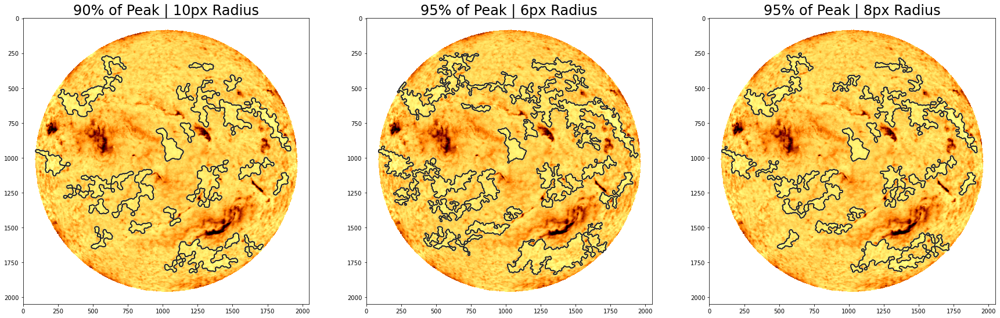

In [436]:
heat_map_title = 'Segmented Hole Number'
color_scale = 'Aggrnyl'
lower_bound = 22
upper_bound = 24

outcome_list = num_holes_list.copy()

plot_heat_map_band(outcome_list, heat_map_title, lower_bound, upper_bound,
                   percent_of_peak_list, morph_radius_list, 
                   edit_im, heat_holes_mask_list, title_list, color_scale)

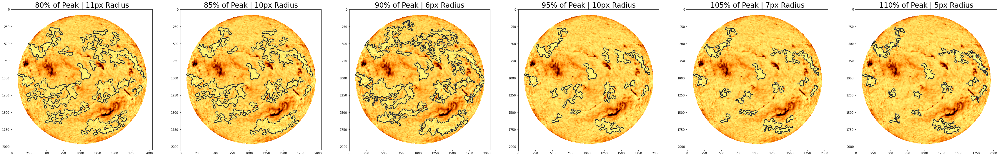

In [446]:
heat_map_title = 'Segmented Hole Number'
color_scale = 'Aggrnyl'
lower_bound = 17
upper_bound = 17

outcome_list = num_holes_list.copy()

plot_heat_map_band(outcome_list, heat_map_title, lower_bound, upper_bound,
                   percent_of_peak_list, morph_radius_list, 
                   edit_im, heat_holes_mask_list, title_list, color_scale)

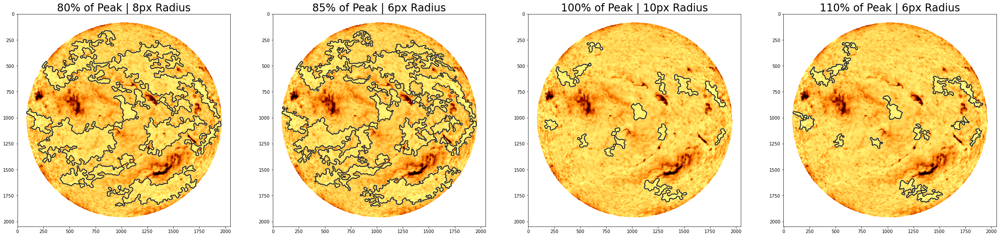

In [438]:
heat_map_title = 'Segmented Hole Number'
color_scale = 'Aggrnyl'
lower_bound = 13
upper_bound = 13

outcome_list = num_holes_list.copy()

plot_heat_map_band(outcome_list, heat_map_title, lower_bound, upper_bound,
                   percent_of_peak_list, morph_radius_list, 
                   edit_im, heat_holes_mask_list, title_list, color_scale)

## Histogram Tail Width

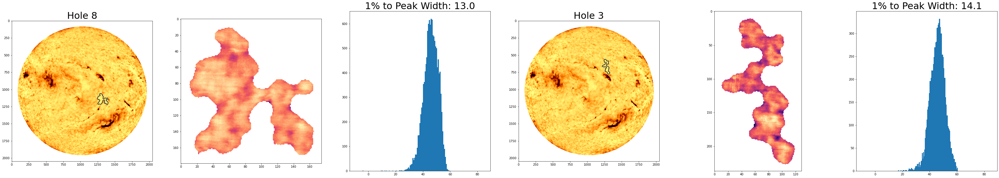

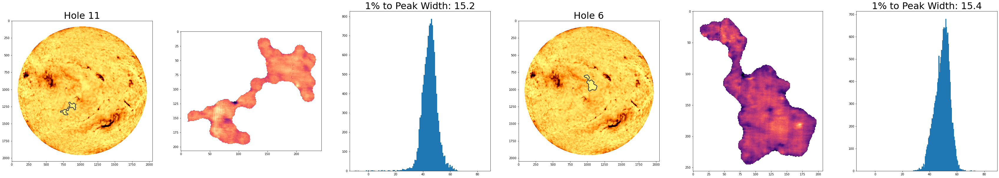

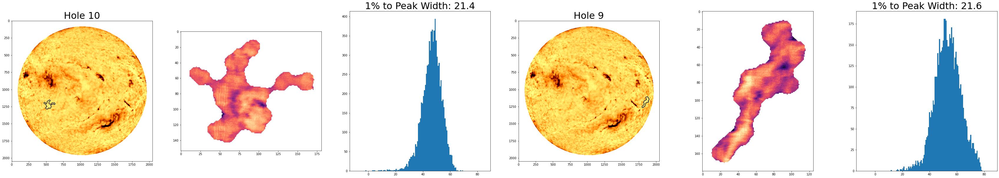

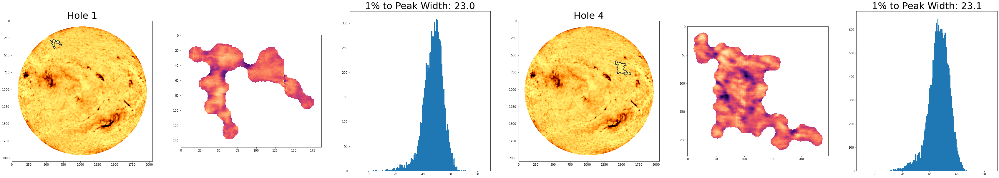

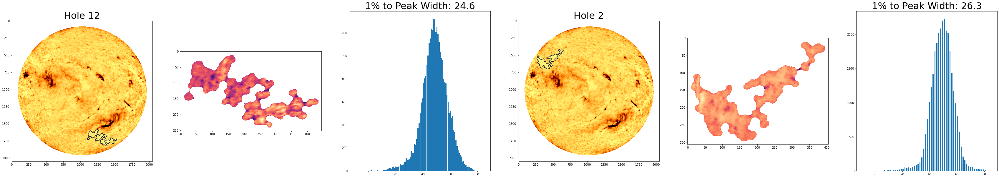

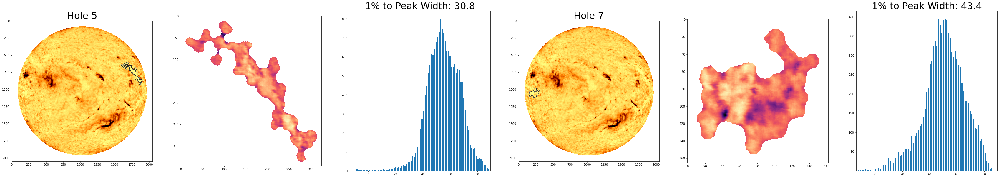

In [413]:
# 0-9
file_num = 9
percent_of_peak = 100
morph_radius = 9

eqw, date = extract_fits(file_num=file_num)[0:4:3]
edit_im = edit_eqw(eqw, peak_count_cutoff_percent=0.1)[0]

thresh_percent = get_percent_to_peak_percent(edit_im, percent_to_peak=percent_of_peak)
holes_mask = get_holes_mask(edit_im, thresh_percent, morph_radius)

plot_hole_tail_widths(edit_im, holes_mask)

In [426]:
lower_tail_width_list = get_lower_tail_width_list(edit_im, heat_holes_mask_list)

In [440]:
heat_map_title = 'Mean CH Tail Width'
color_scale = 'ice'

outcome_list = lower_tail_width_list.copy()

plot_heat_map(outcome_list, heat_map_title, percent_of_peak_list, morph_radius_list, color_scale)

### Heat Map Bands

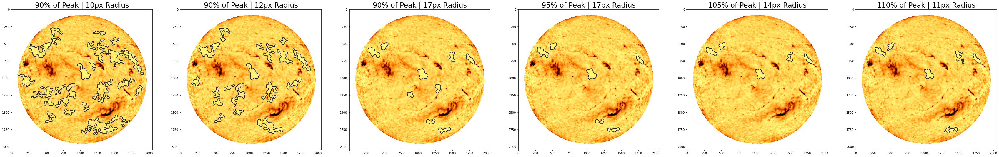

In [445]:
heat_map_title = 'Mean CH Tail Width'
color_scale = 'ice'
lower_bound = 25
upper_bound = 26

outcome_list = lower_tail_width_list.copy()

plot_heat_map_band(outcome_list, heat_map_title, lower_bound, upper_bound,
                   percent_of_peak_list, morph_radius_list, 
                   edit_im, heat_holes_mask_list, title_list, color_scale)

## Multiplied

In [454]:
heat_map_title = 'Multiplied Metrics'
color_scale = 'dense_r'

outcome_list = list(np.array(area_percent_list)*np.array(num_holes_list)*np.array(lower_tail_width_list))

plot_heat_map(outcome_list, heat_map_title, percent_of_peak_list, morph_radius_list, color_scale)

# Ensemble

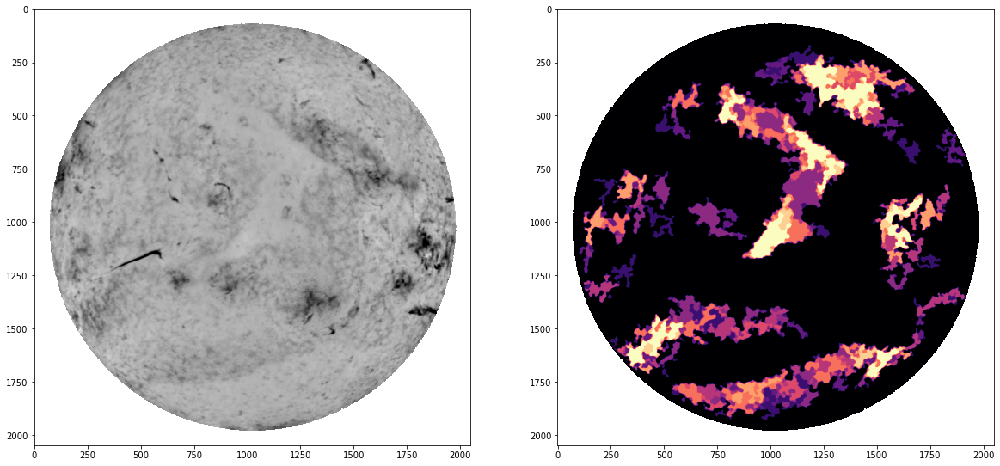

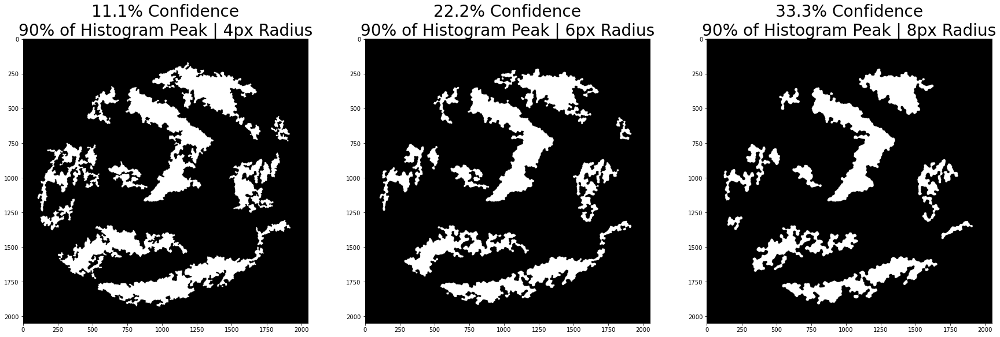

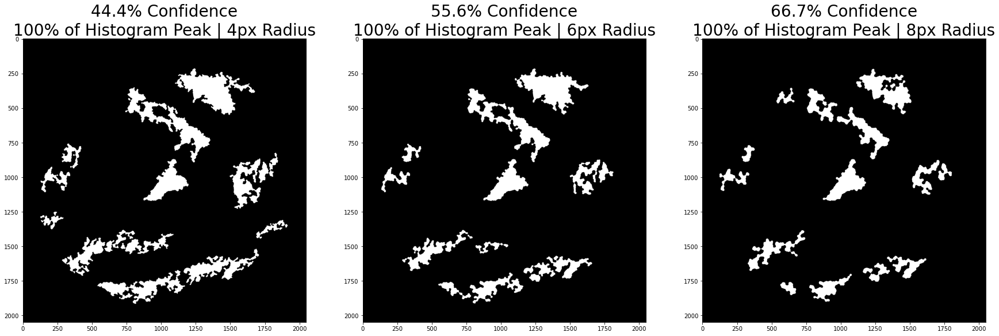

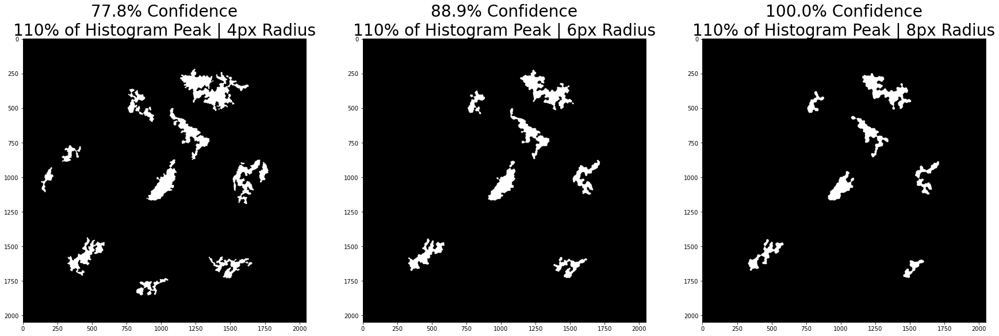

In [43]:
# 0-9
file_num = 8

eqw, date = extract_fits(file_num=file_num)[0:4:3]
edit_im = edit_eqw(eqw, peak_count_cutoff_percent=0.1)[0]

percent_of_peak_list = [90,100,110]
radius_list = [4, 6, 8]

ensemble_map, holes_mask_list, confidence_list = get_ensemble(
    edit_im, percent_of_peak_list, radius_list)

title_list = [f'{percent_of_peak:d}% of Histogram Peak | {radius:d}px Radius'
              for percent_of_peak in percent_of_peak_list
              for radius in radius_list]

plot_ensemble(edit_im, ensemble_map, confidence_list, title_list, holes_mask_list)

## EUV Comparison

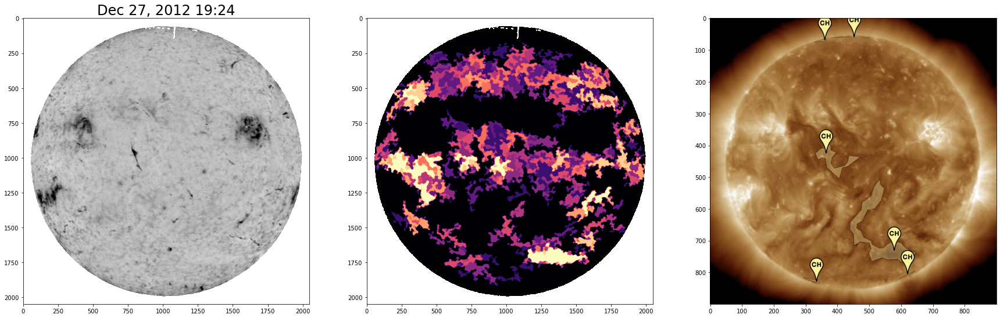

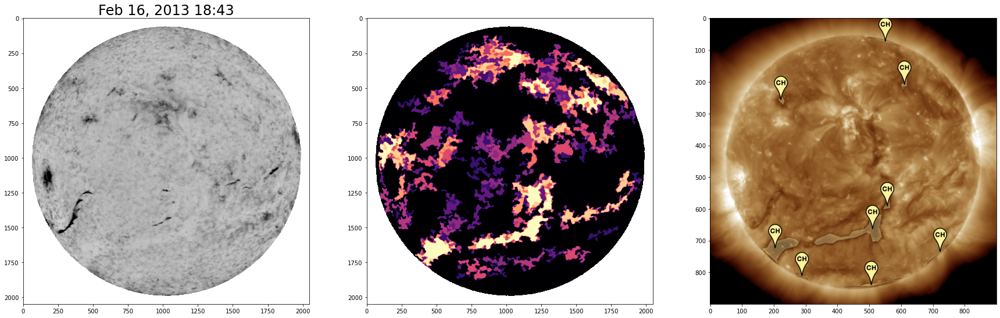

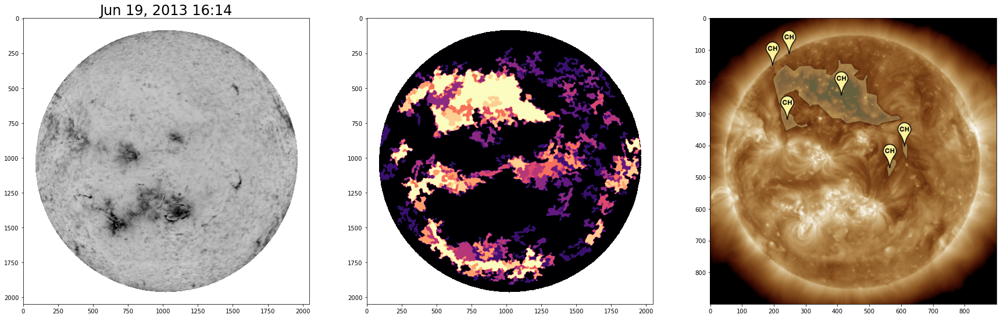

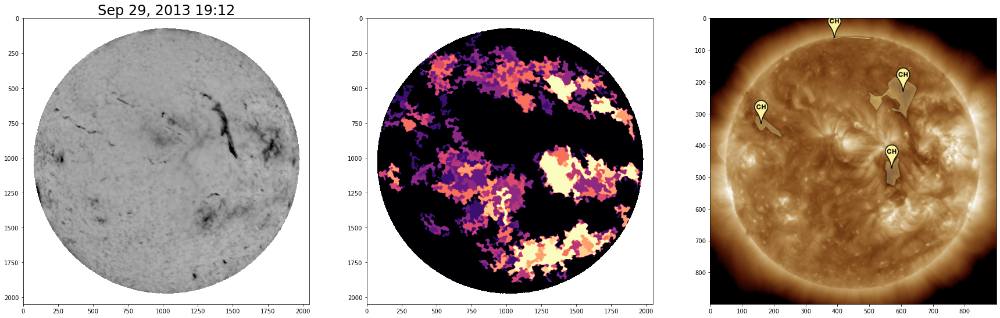

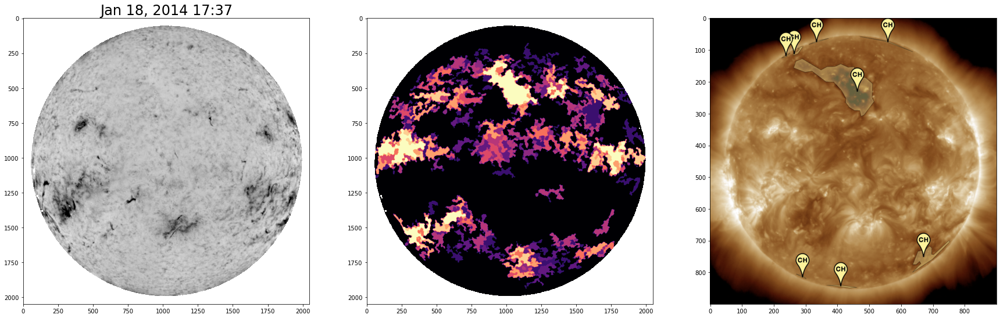

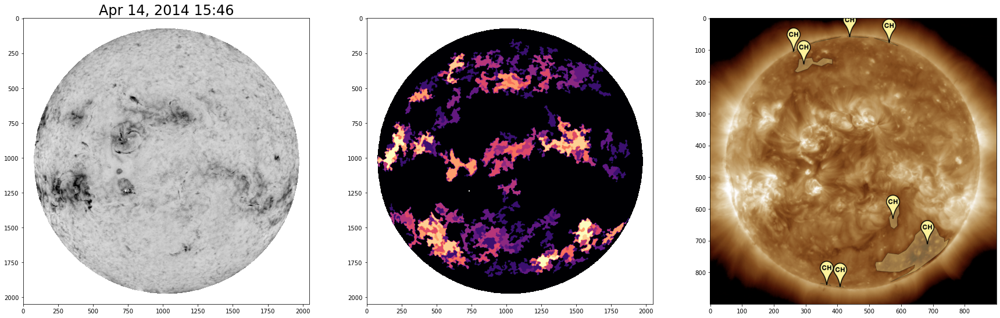

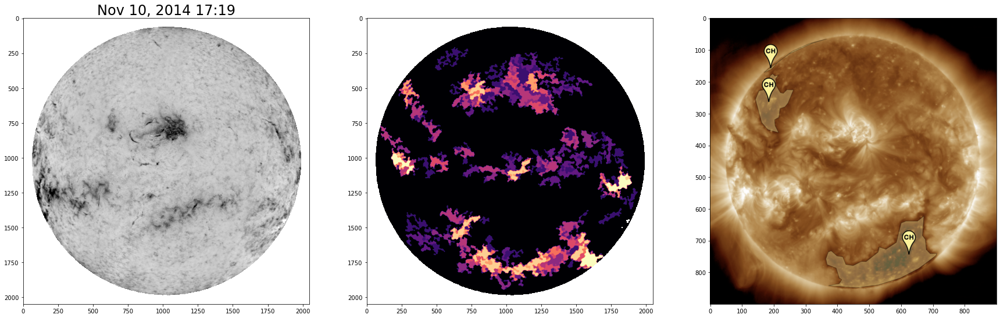

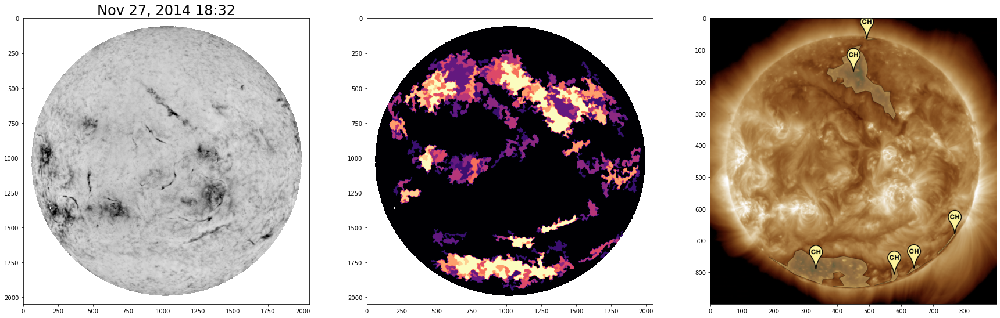

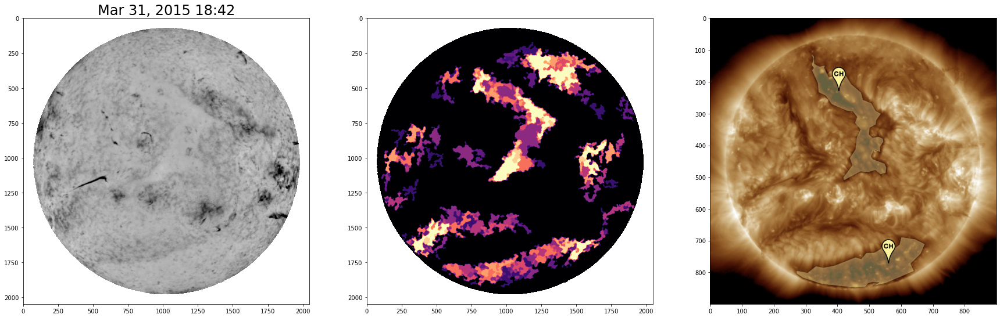

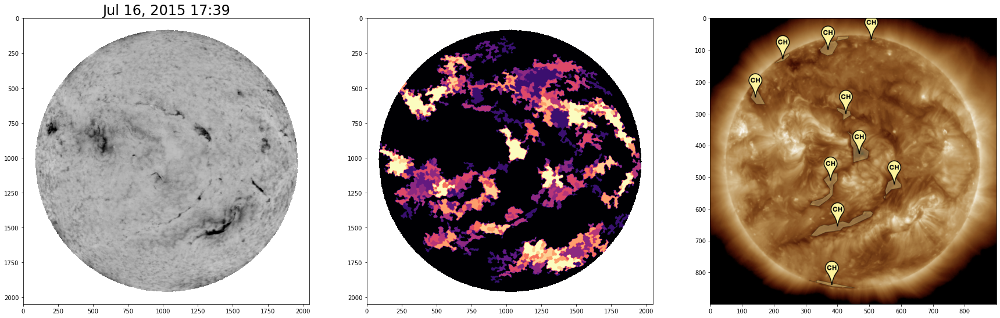

In [1965]:
for file_num in range(10):
    eqw, date = extract_fits(file_num=file_num)[0:4:3]
    eqw_band_cut = edit_eqw(eqw, peak_count_cutoff_percent=0.1)[0]

    edit_im = eqw_band_cut
    
    percent_of_peak_list = list(range(90,111,10))
    radius_list = list(range(4,9,2))

    ensemble_map = get_ensemble(edit_im, percent_of_peak_list, radius_list)[0]

    euv = extract_euv(file_num)

    plot_ensemble_comparison(edit_im, date, ensemble_map, euv)